# Introduction

## The Survey Assay
The Survey assay is a high-throughput spatial transcriptomics assay that combines single-cell RNA sequencing with spatially-resolved gene expression profiling. The assay consists of an array of 1000s of nanowells, each containing a known unique combinatorial DNA barcode. Fresh tissue samples are live sectioned, placed on the array, and incubated. The spatial barcodes infiltrate the tissue, labeling tissue-resident, whole cells at their plasma membrane. The section is removed from the array and input into a standard single-cell dissociation, flow-sorted to identify viable spatially-barcoded cells, and input into standard single-cell sequencing platforms. The spatial barcodes are prepared as a separate library in addition to the transcriptome library, and processed using standard alignment. The resulting outputs are high-quality, single-cell genomics data with spatial metadata.

Survey's assay is
* **simple**, adding an additional 1 hr hands-on time to standard single-cell sequencing from solid tissue;
* **flexible**, compatible with any single-cell downstream sequencing platform that is compatible with poly-A capture of barcode tags;
* **extensible**, to various single-cell workflows like sorting for certain cell types of interest, genetic multiplexing, sample hashing, or capturing multiple modalities including surface protein staining (a la CITE-Seq / BioLegend Total-Seq™) and CRISPR perturbations, without the need for additional development or special spatial chips.


<img src="../assets/survey_workflow.png" width="50%">

## Analysis

In this notebook, we will analyze processed data from a sample dataset generated from wild-type mouse kidney. The data is derived from 2 of our 120 µm-resolution spatial chips, with each one sequenced in its own single-cell sequencing reaction using 10x Genomics Chromium, yielding ~17,000 high-quality cells across the 2 reactions. The data has been filtered and processed using a standard single-cell analysis pipeline, dimensionality-reduced and visualized with UMAP, annotated with cell type information, and spatially mapped using the raw barcode data. Through this analysis, we also make use of some custom plotting and data management tools.

Because of its multi-modal nature, our object of choice for storing the single-cell spatial data is [MuData](https://mudata.readthedocs.io/en/latest/). MuData objects can store multiple [AnnData](https://anndata.readthedocs.io/en/latest/) objects, each representing a different modality, along with shared metadata. If you are unfamiliar with MuData, we recommend perusing the documentation.

# Setup

Here we import the necessary libraries, adjust some settings, and load the processed data.

In [2]:
# Built-ins
from pathlib import Path

# Standard libs
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt


# Single-cell and spatial libs
import mudata as md
import scanpy as sc

# Survey libs
from survey.genplot import (
    subplots,  boxstrip, set_tick_params
    )
from survey.genutils import get_mask
from survey import singlecell as svc
from survey import spatial as svp
from survey.datasets import load as load_survey_dataset

In [ ]:
# Adjust settings to your liking
sc.settings.verbosity = 4
sc.set_figure_params(dpi=80)
md.set_options(pull_on_update=False) # To avoid user warning introduced in mudata v0.2.0: operations on one modality don't automatically update the shared .obs
sc.anndata.settings.remove_unused_categories=True # This is default but setting explicitly for visibility: filtering cells updates categorical labels
%matplotlib inline

## Load in Data

The packaged dataset is a small subset of wild-type mouse kidney data generated internally at Survey Genomics. The data was generated from sections, each on their own chip, and sequenced in separate 10x Genomics Chromium reactions. The data has been processed using a standard single-cell analysis pipeline, dimensionality-reduced and visualized with UMAP, annotated with cell type information, and spatially mapped using the raw barcode data. It has been subsampled to ~5K cells for ease of use in this notebook.

If you have been provided with a fuller dataset by Survey Genomics, you can set the `data_dir` and `mdata_relative_path` variables to point to your data. Otherwise, the default dataset will be loaded.


An explanation of the `mdata` object and some Survey-specific contents:
* The `mdata` contains 2 modalities: `rna` and `xyz`. The `rna` modality contains the gene expression data, while the `xyz` modality contains the spatial locations.

* In the `.uns` of the `xyz` modality, there is a `survey` key with a `survey.spatial.core.ChipSet` object value. This object contains information about the spatial chips used in the assay: the chip version, the barcode layout, segmentation data, and other metadata associated with the chips.

* In all modalities, there is a `meta` key in the `.uns` which contains metadata for various columns in the `.obs`. This is a make-shift solution for a minor gripe I've had with categorical data in pandas dataframes, which can't natively store metadata for individual categories. For more info, see `survey.singlecell.meta`. Throughout the notebook, you will note the module being used to extract metadata, and some of the plotting functions will automatically pull metadata (like colors) if they exist.

* The `mdata` has been saved with only raw data in the `.X` matrices to reduce file size. Normalization and logging is done on-the-fly using Scanpy's built-ins when loading in and added to the `.layers`. This approach ensures the original raw counts are always preserved for analyses that require them, while providing convenient access to a normalized view for most standard workflows.

In [ ]:
# To load the default dataset: 
data_dir = None
mdata_relative_path = None

# # If you were provided with a dataset from Survey Genomics, uncomment this block and set these variables:
# data_dir = Path("/path/to/data-dir/") # Replace with actual path or set to None to use default dataset
# mdata_relative_path = Path("tissue/provided_dataset.h5mu") # Replace with actual relative path or set to None to use default dataset

In [5]:
mdata, paths = load_survey_dataset(data_dir=data_dir, mdata_relative_path=mdata_relative_path)

Normalizing and log-transforming RNA data...
normalizing counts per cell
    finished (0:00:00)


In [6]:
mdata

MuData object with n_obs × n_vars = 15945 × 17330
  2 modalities
    rna:	15945 x 17328
      obs:	'rxn', 'batch', 'n_counts', '%mito', 'leiden', 'ct1', 'ct2', 'chip-num', 'n_genes'
      var:	'n_counts', 'n_cells', 'mean', 'std'
      uns:	'dimred_params', 'neighbors', 'pca', 'umap', 'meta'
      obsm:	'X_pca', 'X_pca_harmony_reordered', 'X_umap'
      varm:	'PCs'
      layers:	'npc-l1p'
      obsp:	'connectivities', 'distances'
    xyz:	14924 x 2
      obs:	'id', 'arr-row', 'arr-col', 'arr-x', 'arr-y', 'arr-center_x', 'arr-center_y', 'sp0', 'sp1', 'chip-num', 'rna.ct1', 'rna.ct2', 'tissue'
      uns:	'meta', 'survey'
      obsm:	'X_survey'

# Global UMAP Visualization

To get a sense of the data, we can visualize the global UMAP colored by various columns of the `.obs`. Of note is the clear separation of cell types and the heterogeneity of gene expression present within the sample.

We use a custom plotting function (`svc.pl.scatter`) that allows for easy visualization of categorical and continuous variables and additional common aesthetic customizations.

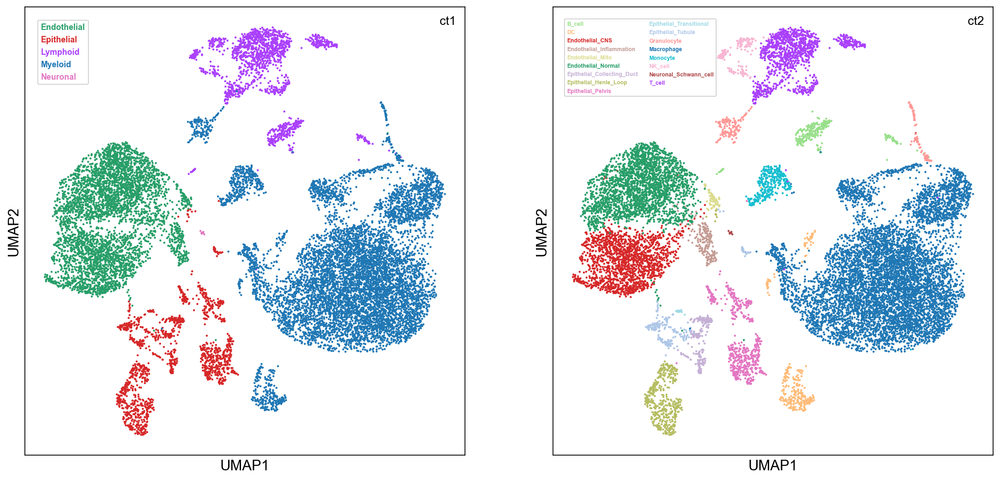

In [7]:
# By cell type, both coarse (ct1) and medium granularity (ct2) annotations
# Note the further heterogeneity in some cell types; these subpopulations are not annotated in this dataset but can be explored further with clustering and marker gene analysis
fig, axes = subplots(2, ar=1.1, fss=8)
legend_params = {
    'ct1': {'prop': {'size': 8, 'weight': 'bold'}},
    'ct2': {'prop': {'size': 5.5, 'weight': 'bold'}, 'ncols': 2},
}
for ct, ax in zip(['ct1', 'ct2'], axes.flat):
    svc.pl.scatter(mdata, color=ct, ax=ax, size=1, legend_params=legend_params[ct])

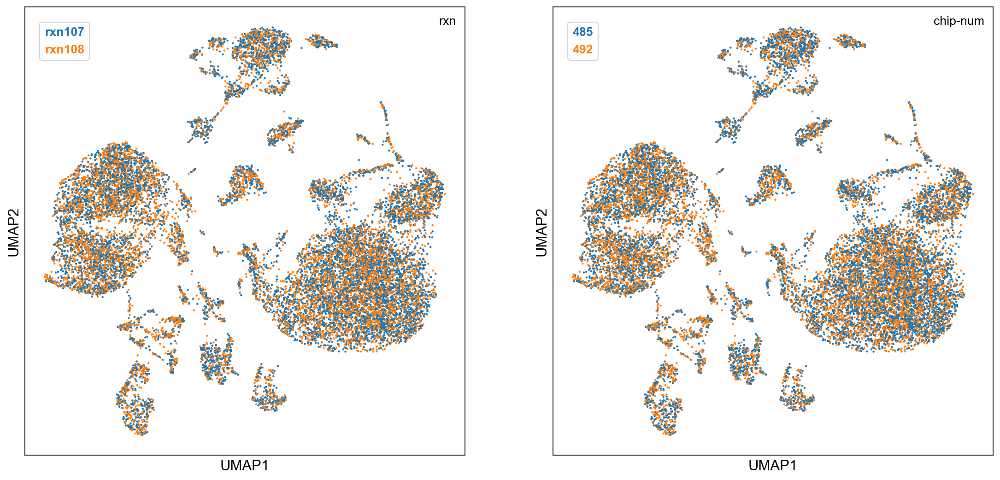

In [10]:
# By single-cell sequencing reaction ID (rxn; akin to "batch") and chip number (chip-num)
# Note that while these chips were each processed in their own rxn, a spatial chip yields typically ~200K spatially-labeled cells that can be run over multiple rxns
fig, axes = subplots(2, ar=1.1, fss=8)
for key, ax in zip(['rxn', 'chip-num'], axes.flat):
    svc.pl.scatter(mdata, color=key, ax=ax, size=1, sort_order=False)

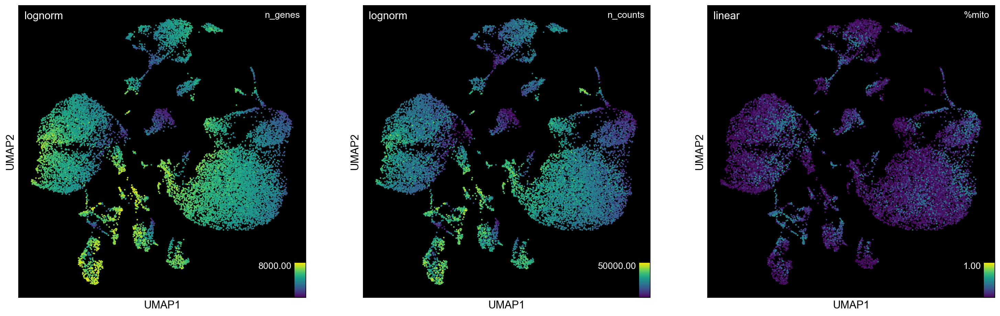

In [11]:
# By various QC metrics
fig, axes = subplots(3, ar=1.1, fss=7)
params = {
    'n_genes': {'norm': mpl.colors.LogNorm(vmax=8e3), 'text': 'lognorm'},
    'n_counts': {'norm': mpl.colors.LogNorm(vmax=5e4), 'text': 'lognorm'},
    '%mito': {'norm': mpl.colors.Normalize(vmax=1), 'text': 'linear'}
}
for key, ax in zip(['n_genes', 'n_counts', '%mito'], axes.flat):
    svc.pl.scatter(mdata, color=key, ax=ax, size=1, invert=True, norm=params[key]['norm'])
    ax.text(0.02, 0.98, params[key]["text"], ha='left', va='top', transform=ax.transAxes, color='white')

# Plot RNA Quality Metrics

## UMIs and Genes per cell

In [12]:
plot_dict = {
    'UMIs': {'label': 'Log(UMIs per cell)', 'y': 'n_counts', 'ymax': 1e5, 'show_legend':False},
    'Genes': {'label': 'Log(Genes per cell)', 'y': 'n_genes', 'ymax': 1e5, 'show_legend':True},
}

strip_kws = {'size' : 3, 'alpha': 0.2}

df = mdata['rna'].obs
cdict = svc.meta.get_cat_dict(mdata['rna'], 'chip-num', 'color')

common_kws = {'palette': cdict}

### By Chip

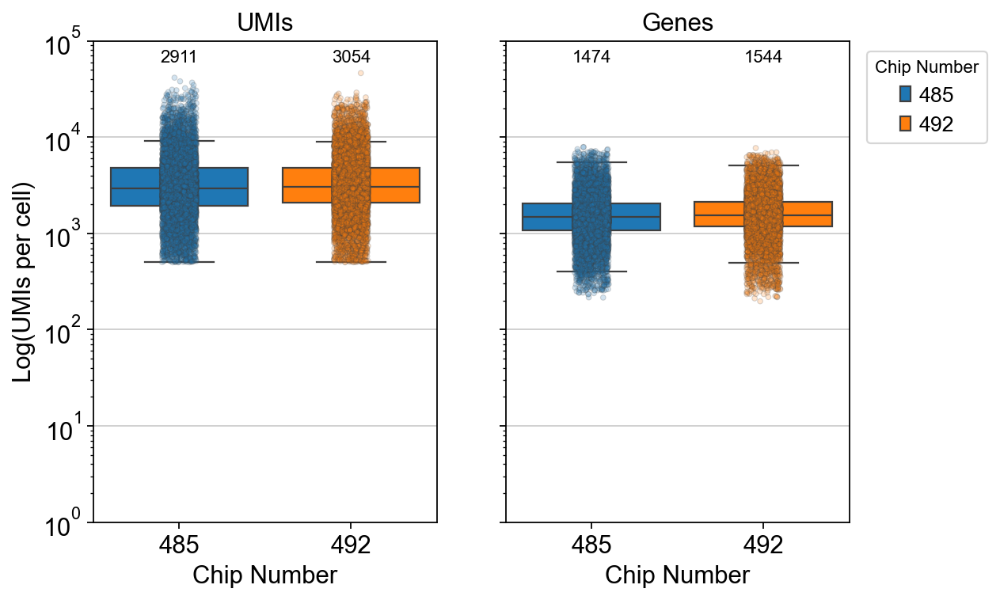

In [13]:
fig, axes = subplots(2, ar=0.8, fss=5, sharey=True)

for (title, pinfo), ax in zip(plot_dict.items(), axes.flat):

    median = df.groupby('chip-num', observed=True)[pinfo['y']].median()

    ax = boxstrip(df=df, x='chip-num', y=pinfo['y'], hue='chip-num', ax=ax, strip_kws=strip_kws, common_kws=common_kws)

    if pinfo['show_legend']:
        ax.legend(bbox_to_anchor=(1.02, 1), loc='upper left', title='Chip Number', title_fontsize='10', fontsize='12')
    else:
        ax.get_legend().remove()

    ax.set_ylabel(pinfo['label'])
    ax.set_xlabel('Chip Number')
    ax.set_yscale('log')
    ax.set_ylim((1, pinfo['ymax']))

    for i, (chipnum, median) in enumerate(median.items()):
        ax.text(i, 0.95, f'{median:.0f}', ha='center', va='bottom', fontsize=10, transform=ax.get_xaxis_transform())
    ax.set_title(title)


### By Cell Type

In [14]:
print([i for i in mdata['rna'].obs.columns if i.startswith('ct')])

['ct1', 'ct2']


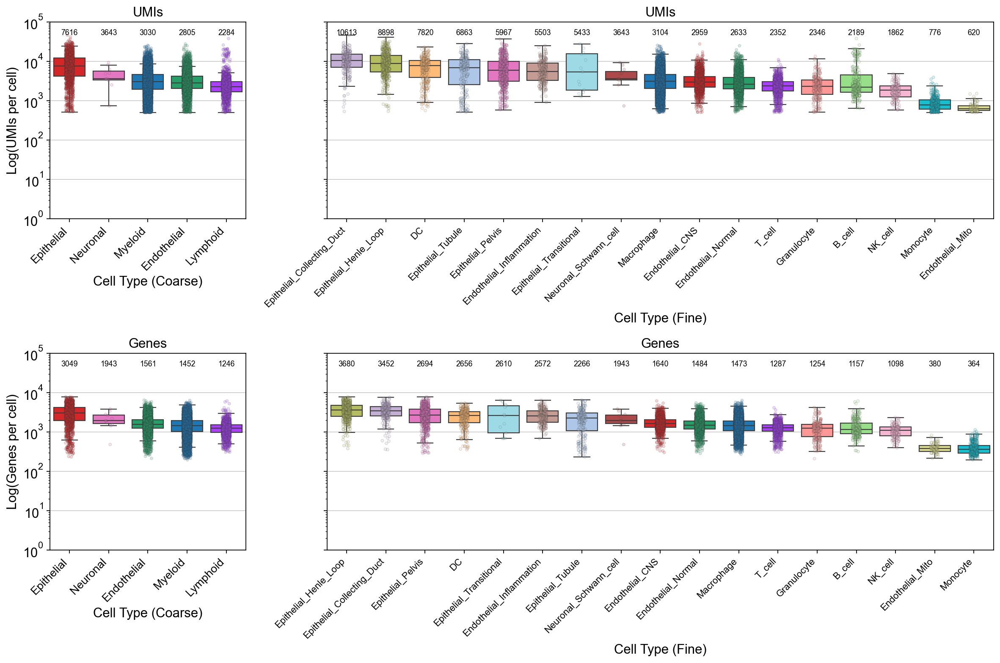

In [15]:
cttypes = {
    'ct1': {'label': 'Cell Type (Coarse)', 'set_tick_params':{'labelsize': 12, 'rotation':45, 'ha':'right'}},
    'ct2': {'label': 'Cell Type (Fine)', 'set_tick_params':{'labelsize': 10, 'rotation':45, 'ha':'right'}},
}
ctsizes = [df['ct1'].cat.categories.size, df['ct2'].cat.categories.size]

fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(15, 10), width_ratios=(ctsizes[0], ctsizes[1]), sharey=True)

for (title, pinfo), ax_row in zip(plot_dict.items(), axes):

    for (cttype, cinfo), ax in zip(cttypes.items(), ax_row):

        median = df.groupby(cttype, observed=True)[pinfo['y']].median().sort_values(ascending=False)
        cdict = svc.meta.get_cat_dict(mdata['rna'], cttype, 'color')
        
        common_kws = {'order': median.index.tolist(), 'palette': cdict}

        ax = boxstrip(df=df, x=cttype, y=pinfo['y'], hue=cttype, ax=ax, strip_kws=strip_kws, common_kws=common_kws)

        ax.set_ylabel(pinfo['label'])
        ax.set_xlabel(cttypes[cttype]['label'])
        ax.set_yscale('log')
        ax.set_ylim((1, pinfo['ymax']))
        ax = set_tick_params(ax, axis='x', **cinfo.get('set_tick_params'))

        for i, (ct, median) in enumerate(median.items()):
            ax.text(i, 0.925, f'{median:.0f}', ha='center', va='bottom', fontsize=8, transform=ax.get_xaxis_transform())
        ax.set_title(title)

plt.tight_layout()


# Plot DE Genes

Plot the top DE genes for each cell type on the UMAP. Using scanpy's built-in `rank_genes_groups` function with the default t test.

## `ct1`

Here I'll plot the top 3 genes for each cell type in the `ct1` annotation.

In [16]:
dges = []
gb = 'ct1'
cts = mdata['rna'].obs[gb].cat.categories

print(len(cts))
for ct in cts:
    dges.append(svc.celltype.rank_genes(mdata['rna'], g=ct, r='rest', gb=gb))
dge = pd.concat(dges, axis=0, keys=cts, names=[gb, 'gene'])

5


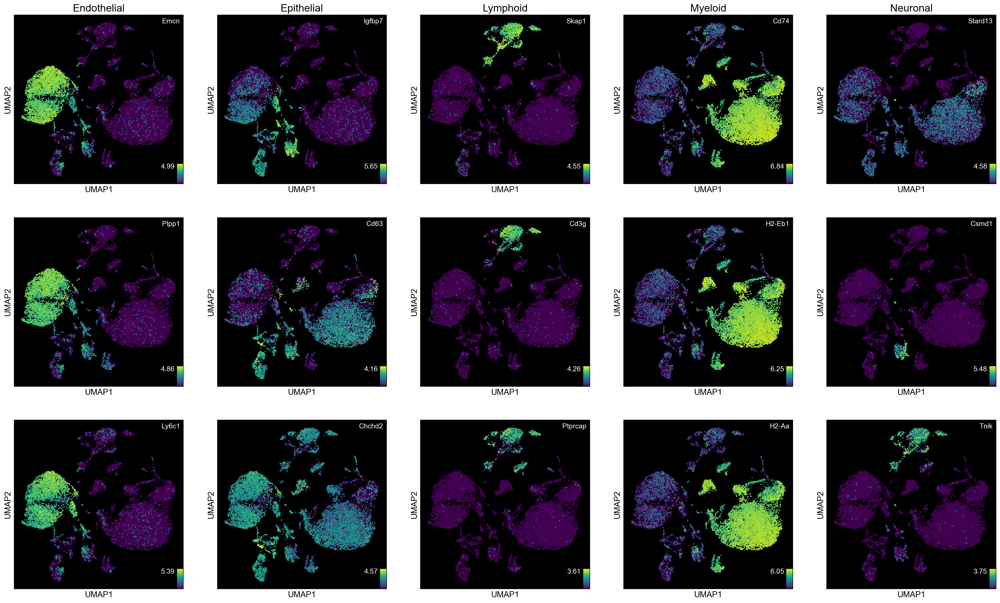

In [17]:
n = 3
fig, axes = subplots(len(cts)*n, ncols=len(cts), ar=1, fss=6)
for ct, ax_col in zip(cts, axes.T):
    for gene, (i, ax) in zip(dge.loc[ct].head(n)['names'], enumerate(ax_col)):
        ax = svc.pl.scatter(mdata['rna'], color=gene, ax=ax, invert=True, sort_order=True, basis='umap', layer='npc-l1p')
        if i == 0:
            ax.set_title(ct, fontsize=18)

## `ct2`

For the `ct2` annotation, I'll plot just the top gene for each cell type on the UMAP.

In [18]:
dges = []
gb = 'ct2'
cts = mdata['rna'].obs[gb].cat.categories

print(len(cts))
for ct in cts:
    dges.append(svc.celltype.rank_genes(mdata['rna'], g=ct, r='rest', gb=gb))
dge = pd.concat(dges, axis=0, keys=cts, names=[gb, 'gene'])

17


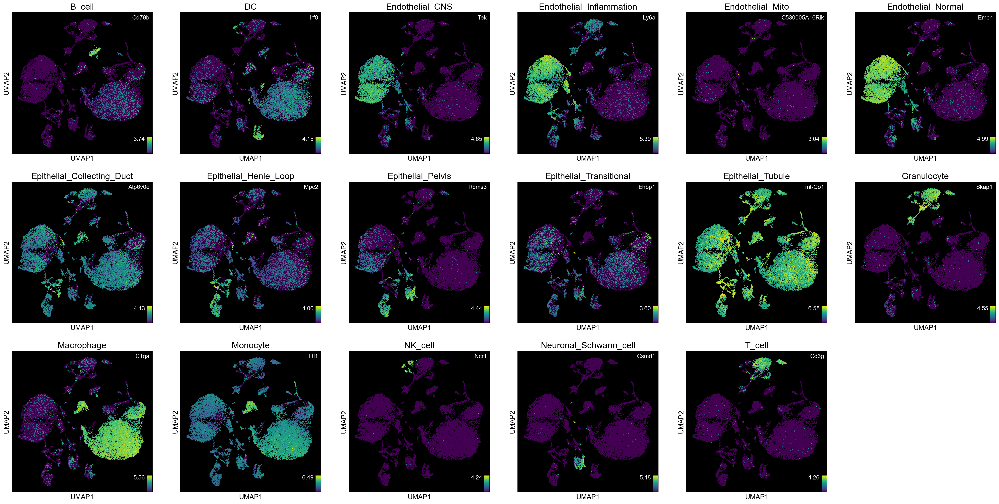

In [19]:
fig, axes = subplots(len(cts), ncols=6, ar=1, fss=6)
for ct, ax in zip(cts, axes.flat):
    gene = dge.loc[(ct, 1), 'names']
    ax = svc.pl.scatter(mdata['rna'], color=gene, ax=ax, invert=True, sort_order=True, basis='umap', layer='npc-l1p')
    ax.set_title(ct, fontsize=18)

# Spatial Maps

Here we will use the `svp.pl.survey_plot` function to plot the spatial locations of cells on the chip. The function automatically pulls in chip metadata from the `mdata`'s `chipset`, and can color by any feature (`.var_names`) or any column in any individual modality's `.obs`, calling `svc.pl.scatter` under the hood.

## Prepare `mdata`

First, we'll pull some of the `.obs` columns from the individual modalities to the global `.obs` for easier access.

We'll also make a subset of the data that only shows cells overlapping tissue (based on segmentation of the tissue boundary using orthogonal imaging). Localization outside the tissue area is often due to residual cell-containing liquid from the fresh sections acquiring labels from distal wells.

In [20]:
mdata.pull_obs(['ct1', 'ct2', 'chip-num', 'tissue'], mods=['rna', 'xyz'])

In [21]:
mask = get_mask(mdata.obs, {'xyz:tissue': ['tissue']})
submdata = mdata[mask]

In [23]:
percent_on_tissue = 100*mask.sum()/mdata.n_obs
print(f'Cells on tissue: {mask.sum()} ({percent_on_tissue:.0f}%)')

Cells on tissue: 14636 (92%)


## Plot Cells

### By Cell Type

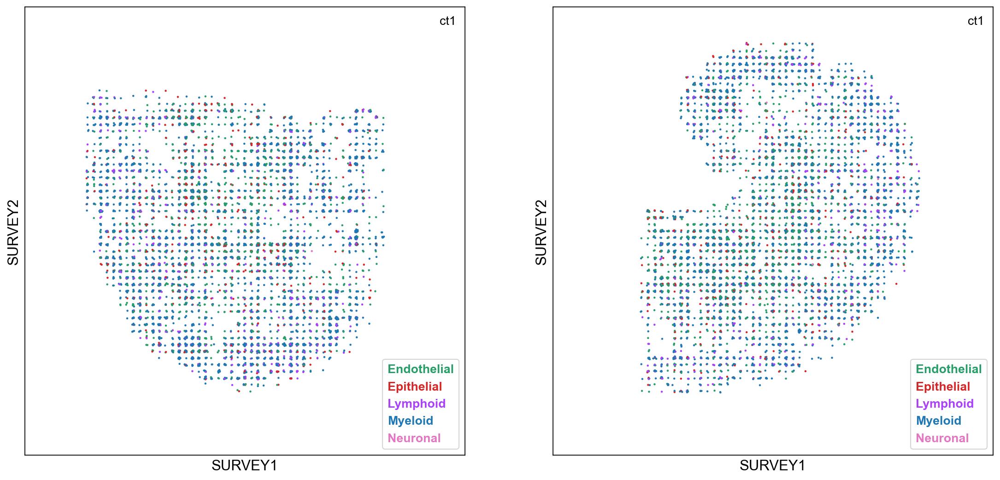

In [24]:
cats = submdata['rna'].obs['ct1'].cat.categories
legend_params = {'show_all_cats': cats}
fig, axes = subplots(2, ar=1.1, fss=8)
for chipnum, ax in zip(submdata.obs['rna:chip-num'].cat.categories, axes):
    svp.pl.survey_plot(submdata, chipnum=chipnum, color='ct1', ax=ax, sort_order=False, 
                       legend_params=legend_params)

### With Background Image

Here we show the orthogonal imaging of the tissue on the array, taken with a low-resolution benchtop microscope. The yellow tinge of some chips indicates they were manufactured through 3D printing (the biocompatible resin used for fabrication is yellow). Other chips, made from LSR, are translucent.

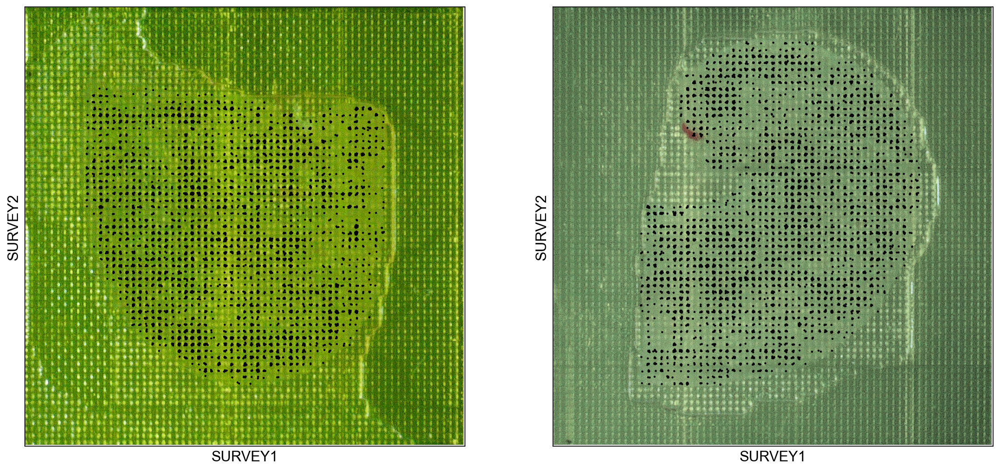

In [25]:
fig, axes = subplots(2, ar=1.1, fss=8)
for chipnum, ax in zip(submdata.obs['rna:chip-num'].cat.categories, axes):
    svp.pl.survey_plot(submdata, chipnum=chipnum, color='k', ax=ax, img=(paths['imgs'], 0))

### Specific Cell Type

You can subset the data to plot only specific cell types of interest.

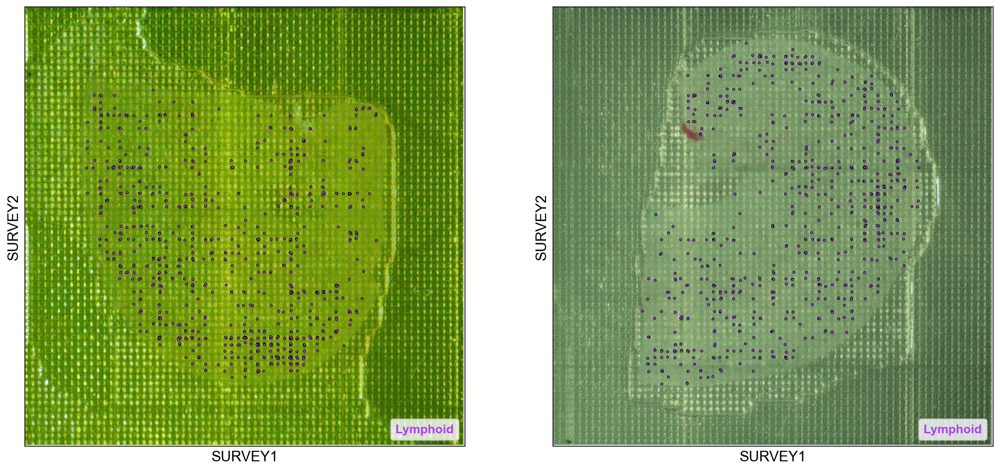

In [26]:
ct = np.random.choice(submdata['rna'].obs['ct1'].cat.categories)
ct_submdata = submdata[submdata.obs['rna:ct1'].isin([ct])]

show_cats = ct_submdata['rna'].obs['ct1'].cat.categories
legend_params = {'show_all_cats': show_cats}

fig, axes = subplots(2, ar=1.1, fss=8)
for chipnum, ax in zip(ct_submdata.obs['rna:chip-num'].cat.categories, axes):
    ax = svp.pl.survey_plot(ct_submdata, chipnum=chipnum, color='ct1', linewidth=0.5, edgecolor='k', size=5, ax=ax, img=(paths['imgs'], 0),
                            legend_params=legend_params, plot_label=False)

## Plot Any Gene

Because we have unbiased, poly-A RNA-seq data, we can plot the spatial gene expression of any detected gene.

In [27]:
def get_gene(random=True, ct2=None):
    if random:
        # Random moderately expressed gene
        genes = submdata['rna'].var['n_counts'].sort_values(ascending=False).head(2000).tail(500)
        gene = genes.sample(1).index[0]
        return (None, gene)
    else:
        # Random DE gene
        if ct2 is None:
            ct2 = np.random.choice(submdata['rna'].obs['ct2'].cat.categories)
        gene = dge.xs(ct2).iloc[0]['names']
        return (ct2, gene)

### Plotted In Individual Cells

In [28]:
# Choose to plot a random gene or the top DE gene from a random cell type

# ct2, gene = get_gene(random=True)
ct2, gene = get_gene(random=False)

print((ct2, gene))

('Epithelial_Pelvis', 'Igfbp7')


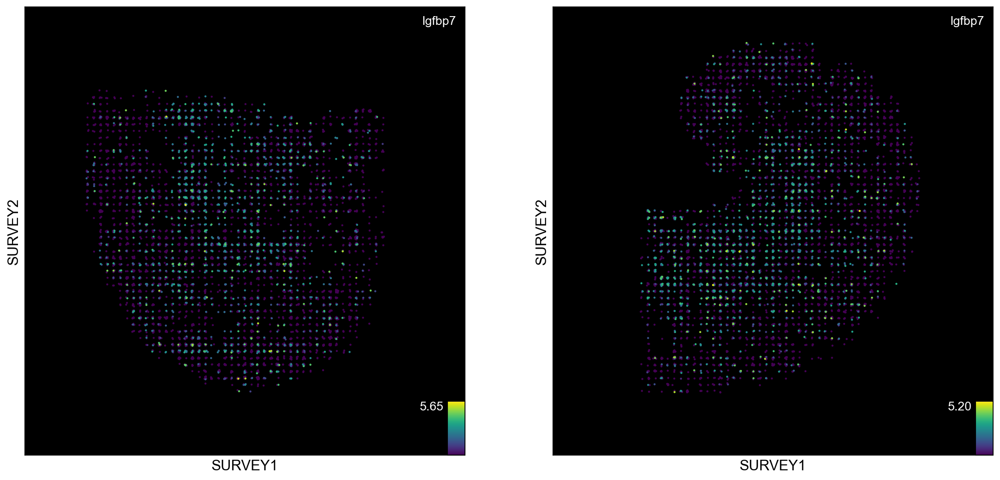

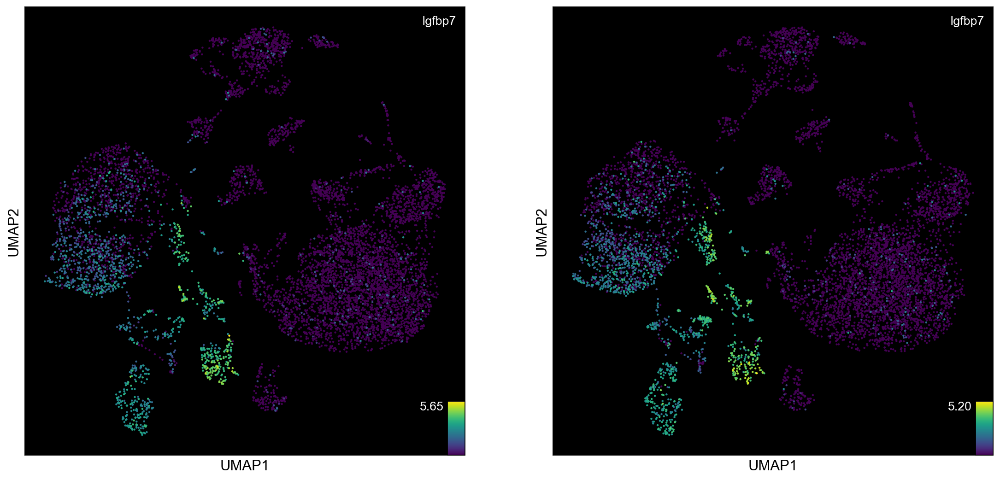

In [29]:
fig, axes = subplots(2, ar=1.1, fss=8)
for chipnum, ax in zip(submdata.obs['rna:chip-num'].cat.categories, axes):
    svp.pl.survey_plot(submdata, chipnum=chipnum, color=gene, layer='npc-l1p', invert=True, ax=ax)

fig, axes = subplots(2, ar=1.1, fss=8)
for chipnum, ax in zip(submdata.obs['rna:chip-num'].cat.categories, axes):
    chip_submdata = submdata[submdata.obs['rna:chip-num'] == chipnum]
    ax = svc.pl.scatter(chip_submdata['rna'], color=gene, basis='umap', layer='npc-l1p', invert=True, sort_order=True, ax=ax)

### Averaged per Well

The `survey_plot` function can also plot gene expression per well: supplied with any aggregation function (e.g. np.mean), it will compute the function over all cells in the well.

In [30]:
ct2, gene = get_gene(random=True)
# ct2, gene = get_gene(random=False)

print((ct2, gene))

(None, 'Tnfsf10')


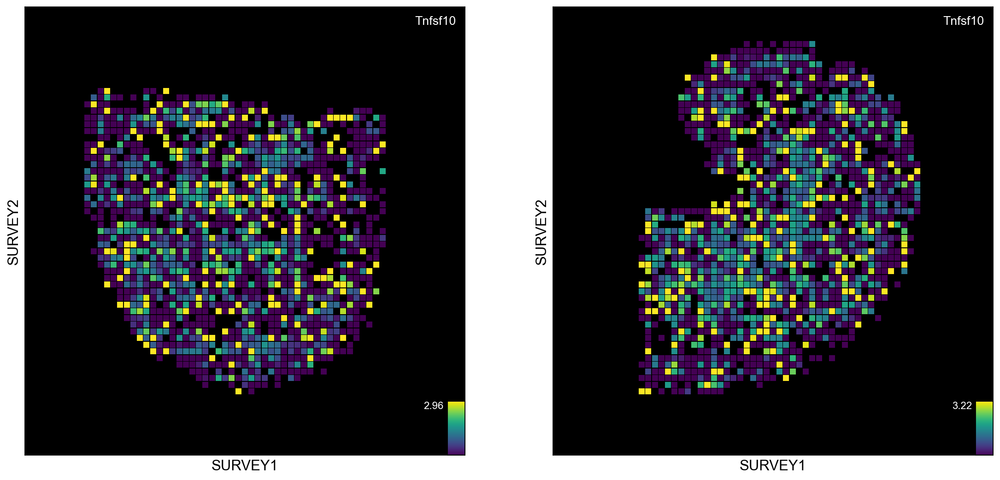

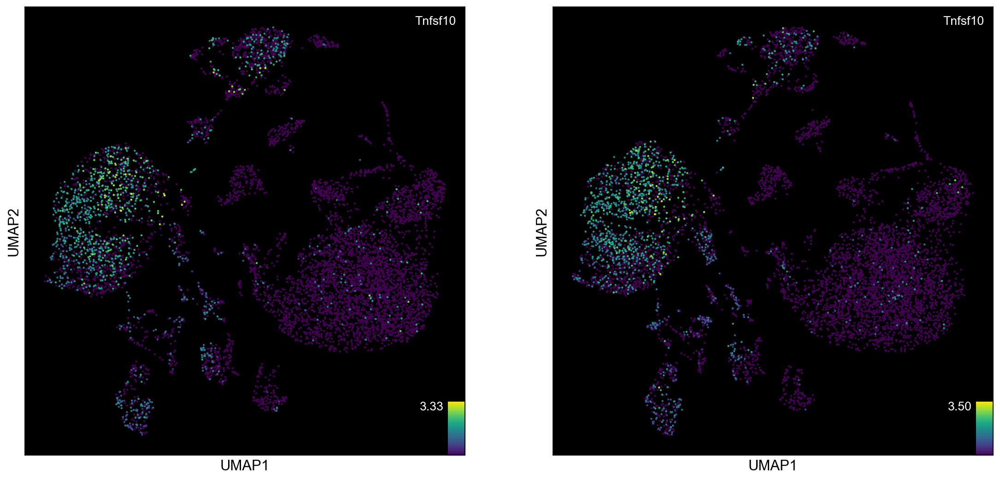

In [31]:
fig, axes = subplots(2, ar=1.1, fss=8)
for chipnum, ax in zip(submdata.obs['rna:chip-num'].cat.categories, axes):
    svp.pl.survey_plot(submdata, chipnum=chipnum, color=gene, ax=ax, wells=np.mean, layer='npc-l1p', invert=True)

fig, axes = subplots(2, ar=1.1, fss=8)
for chipnum, ax in zip(submdata.obs['rna:chip-num'].cat.categories, axes):
    chip_submdata = submdata[submdata.obs['rna:chip-num'] == chipnum]
    # ax = svc.pl.scatter(chip_submdata['rna'], color=gene, basis='umap_hq', layer='npc-l1p', invert=True, sort_order=True, ax=ax)
    ax = svc.pl.scatter(chip_submdata['rna'], color=gene, basis='umap', layer='npc-l1p', invert=True, sort_order=True, ax=ax)

# Summary

This notebook has demonstrated the analysis of spatial single-cell RNA-seq data generated using the Survey assay. We have visualized the data in UMAP space, examined quality metrics, identified and visualized differentially expressed genes, and mapped gene expression and cell types back to their spatial locations on the chip. 

The `survey` package is in active development. There are more tools within the package, so feel free to explore. Improvements are on the way, and of course, we welcome any feedback.

The flexibility of the Survey assay allows for a wide range of downstream analyses and applications in spatial transcriptomics. We have more datasets to come demonstrating more tissue types (liver, spleen, brain), surface protein staining (with 120+ antibodies), genetic multiplexing, and CRISPR perturbations, all with spatial context.